# Introduction à l'apprentissage par renforcement
# TP 1 - les manchots multi-bras

1/4 de la note finale est liée à la mise en forme : 

* pensez à nettoyer les outputs inutiles (installation, messages de débuggage, ...)
* soignez vos figures : les axes sont-ils faciles à comprendre ? L'échelle est adaptée ? 
* commentez vos résultats : vous attendiez-vous à les avoir ? Est-ce étonnant ? Faites le lien avec la théorie.

Ce TP reprend l'exemple d'un médecin et de ses vaccins. Vous allez comparer plusieurs stratégies et trouver celle optimale.
Un TP se fait seul ou en binôme. Aucun groupe de plus de 2 personnes. 

Vous allez rendre le TP depuis un lien GitHub avec ce notebook mais une version du rapport exportée en PDF & HTML. 

In [1]:
%%capture
!pip install matplotlib tqdm numpy ipympl opencv-python
!jupyter labextension install @jupyter-widgets/jupyterlab-manager
!jupyter labextension install jupyter-matplotlib

In [2]:
%load_ext autoreload
%autoreload 2
%matplotlib inline 

import typing as t
import math
import torch
import numpy as np
from tqdm.auto import trange, tqdm
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import matplotlib.animation as animation
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas
import cv2
from IPython.display import display, clear_output, HTML
import random

torch.random.manual_seed(0)

K = 5 # num arms

# Présentation du problème

In [3]:
class ArmBernoulli:
    def __init__(self, p: float):
        """
        Vaccine treatment following a Bernoulli law (mean is p and variance is p(1-p)
        Args:
             p (float): mean parameter
             
        >>> torch.random.manual_seed(random_state)        
        >>> arm = ArmBernoulli(0.5)
        >>> arm.sample(5)
        tensor([ True, False,  True,  True,  True])
        """
        self.immunity_rate = p

    def sample(self, n: int = 1):
        return torch.rand(n) < self.immunity_rate
    
    def __repr__(self):
        return f'<ArmBernoulli p={self.immunity_rate}' 

def generate_arms(num_arms: int):
    means = torch.rand(K)
    MAB = [ArmBernoulli(m) for m in means]
    assert MAB[0].immunity_rate == means[0]
    assert (MAB[0].sample(10) <= 1).all() and (MAB[0].sample(10) >= 0).all() 
    return MAB

MAB = generate_arms(K)

Ce TP reprend l'exemple du médecin présenté en cours.


**Q1. Créez une fonction pour trouver $\mu^*$ à partir d'un `MAB`. Comment est définie la récompense $R_k$ ? Que représente concrètement le regret dans le contexte de ce TP ?**

In [4]:
def find_mu_star_index(MAB: t.List[ArmBernoulli]):
    return torch.argmax(torch.tensor([arm.immunity_rate for arm in MAB]))

mu_star_index = find_mu_star_index(MAB)
print(f"L'index de mu* est: {mu_star_index}")

def find_mu_star_value(MAB: t.List[ArmBernoulli]):
    return max(arm.immunity_rate for arm in MAB)

mu_star_value = find_mu_star_value(MAB)
print(f"La valeur de mu* est: {mu_star_value}")

L'index de mu* est: 1
La valeur de mu* est: 0.7682217955589294


Le regret est une mesure qui représente la différence entre ce que le médecin aurait pu obtenir s'il avait toujours choisi le meilleur vaccin et ce qu'il a réellement obtenu.
Le meilleur vaccin est celui avec le taux d'immunité le plus élevé, c'est-à-dire μ∗. 
Or le médecin peut avoir choisi des vaccins peut-être moins efficaces au cours des essais.

**Note importante :** pour la suite, les résultats seront généralement réalisés avec 100 initialisations différentes du MAB (tous les MAB ont 5 vaccins mais des taux d'immunistation différent) pour réduire le bruit de simulation. Concrètement, on exécutera au moins 100x `generate_arms`.

# I. Cas classique des bandits manchots 

## I.a. Solution Gloutonne

Le médecin fonctionne sur deux phases :

1. **Exploration :** Le médecin calcule le taux d'immunisation empirique sur les N premiers patients en administrant le même nombre de fois chaque vaccin :

$$\hat{\mu_i}[0\rightarrow N] = \frac{1}{T_i} \sum_{k=0}^{N-1} \chi_{v_k,i}R_k,$$

avec $T_i = \sum_{k=0}^{N-1} \chi_{v_k,i}$.


2. **Exploitation :** Le vaccin $v_i = \arg\max_j \hat{\mu_j}[0\rightarrow N]$ est utilisé pour les M patients suivants.

**Q2. Implémentez cette solution avec N = 50 et M = 500 et testez-la avec 100 MAB. On souhaite savoir si vous trouvez le vaccin optimal à l'issue d'une phase d'exploration. Quelle est l'espérance empirique de cette variable ? Et son écart-type ? Calculez de même l'espérance et l'écart-type du regret sur vos 100 simulations.**

Pour rappel, le regret est défini par :

$$r_n = n\mu^* - \sum_{k=0}^{n-1} R_k$$

**Attention :** $n$ est le nombre total de patients, donc ici $N + M$.

In [5]:
N = 50 # Number of patients for exploration
M = 500 # Number of patients for exploitation
n = N + M # Total number of patients


def greedy_solution(MAB: t.List[ArmBernoulli], N: int = 50 , M: int = 500 ):
    rewards = torch.zeros(K)
    trials = torch.zeros(K)

    # Exploration
    for i in range(0,N,1):
        
        arm_index = torch.randint(0, K, (1,)).item()
        reward = MAB[arm_index].sample().float().item()

        rewards[arm_index] += reward
        trials[arm_index] += 1
    
    empirical_means = rewards / trials
    best_vaccine = torch.argmax(empirical_means).item()

    # Exploitation
    total_reward = rewards.sum().item()
    for i in range(0, M, 1):
        reward = MAB[best_vaccine].sample().float().item()
        total_reward += reward
    
    return total_reward, rewards, trials

# Simulation
def simulate(N: int = 50, M: int = 500, num_simulations: int = 100):
    regrets = []
    exploration_successes = []


    for i in range(0, num_simulations, 1):


        MAB = generate_arms(K) # K arms, K = 5
        mu_star = find_mu_star_value(MAB)
        total_reward, rewards, trials = greedy_solution(MAB, N, M)
        
        total_patients = N + M
        regret = total_patients * mu_star - total_reward
        regrets.append(regret)
        
        best_vaccine_index = torch.argmax(torch.tensor([arm.immunity_rate for arm in MAB])).item()

        if (best_vaccine_index == torch.argmax(rewards / trials).item()):
            exploration_successes.append(1)
        
        else:
            exploration_successes.append(0)

    # Stats
    mean_regret = np.mean(regrets)
    std_regret = np.std(regrets)

    mean_exploration_success = np.mean(exploration_successes)
    std_exploration_success = np.std(exploration_successes)

    return mean_exploration_success, std_exploration_success, mean_regret, std_regret

num_simulations = 100
mean_exploration_success, std_exploration_success, mean_regret, std_regret = simulate(N, M, num_simulations)

print(f"Espérance empirique de la réussite de l'exploration : {mean_exploration_success}")
print(f"Écart-type de la réussite de l'exploration : {std_exploration_success}")
print(f"Espérance empirique du regret : {mean_regret}")
print(f"Écart-type du regret : {std_regret}")
        

Espérance empirique de la réussite de l'exploration : 0.76
Écart-type de la réussite de l'exploration : 0.4270831300812525
Espérance empirique du regret : 33.71997833251953
Écart-type du regret : 40.201202392578125


**Q3. On étudie maintenant l'influence de la taille du training set $N$. On considère que N+M est une constante, puis on fait varier N entre K et M. Calculez le regret pour ces différentes tailles du training set  différents MAB et representez le regret moyen, le regret min et max (vous devriez trouver une courbe en U ou en V pour le regret moyen). Quelle est la taille optimale du training set ?**

Le minimum de regret est atteint pour N=55 avec un regret de 25.3706111907959 concernant 10 simulations
Le minimum de regret est atteint pour N=55 avec un regret de 13.861010551452637 concernant 50 simulations
Le minimum de regret est atteint pour N=55 avec un regret de 35.238014221191406 concernant 100 simulations


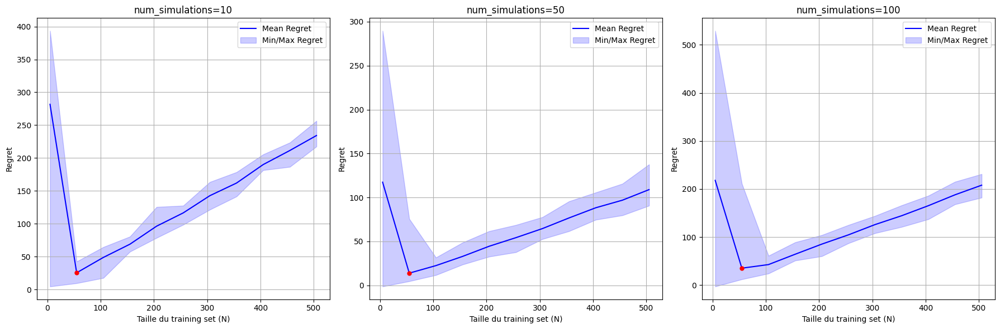

In [6]:
# Fonction pour simuler le regret pour une valeur donnée de N
def simulate_regret(N, M, MAB, num_simulations=100):
    K = len(MAB)
    total_patients = N + M

    regrets_sim = []

    for _ in range(num_simulations):
        rewards = torch.zeros(K)
        trials = torch.zeros(K)
        total_reward = 0

        # Phase d'exploration
        for i in range(N):
            arm_index = torch.randint(0, K, (1,)).item()
            reward = MAB[arm_index].sample().float().item()
            rewards[arm_index] += reward
            trials[arm_index] += 1
            total_reward += reward

        best_vaccine = torch.argmax(rewards / trials).item()

        # Phase d'exploitation
        for i in range(M):
            reward = MAB[best_vaccine].sample().float().item()
            rewards[best_vaccine] += reward
            total_reward += reward

        regret = total_patients * find_mu_star_value(MAB) - total_reward
        regrets_sim.append(regret)
    # Même chose que pour simulate mais ici on stock les regrets
    mean_regret = torch.tensor(regrets_sim).mean().item()
    min_regret = torch.tensor(regrets_sim).min().item()
    max_regret = torch.tensor(regrets_sim).max().item()

    return mean_regret, min_regret, max_regret


def simulation_plot(num_simulations=100):
    K = 5
    N_plus_M = 550  # N + M constante
    N_values = range(K, N_plus_M - K + 1, 50)

    MAB = generate_arms(K)

    mean_regrets = []
    min_regrets = []
    max_regrets = []
    minimum_x = 0 # Coordonnées du minimum de regret
    minimum_y = 0
    
    minimum_value = float('inf')

    # Pour chaque valeur de N
    for N in N_values:
        M = N_plus_M - N
        mean_regret, min_regret, max_regret = simulate_regret(N, M, MAB, num_simulations)
        # Get the minimum regret coordinates
        if mean_regret < minimum_value:
            minimum_value = mean_regret
            minimum_x = N
            minimum_y = mean_regret
        mean_regrets.append(mean_regret)
        min_regrets.append(min_regret)
        max_regrets.append(max_regret)

    return N_values, mean_regrets, min_regrets, max_regrets, minimum_x, minimum_y

# Visualiser les résultats
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
simulations = [10, 50, 100]

for i, num_simulations in enumerate(simulations):
    ax = axes[i]
    N_values, mean_regrets, min_regrets, max_regrets, minimum_x, minimum_y = simulation_plot(num_simulations=num_simulations)
    ax.plot(N_values, mean_regrets, label='Mean Regret', color='blue')
    ax.fill_between(N_values, min_regrets, max_regrets, color='blue', alpha=0.2, label='Min/Max Regret')
    ax.set_title(f"num_simulations={num_simulations}")
    ax.set_xlabel("Taille du training set (N)")
    ax.set_ylabel("Regret")
    ax.legend()
    ax.grid(True)
    ax.plot(minimum_x, minimum_y, marker='o', color='red', markersize=5)
    print(f'Le minimum de regret est atteint pour N={minimum_x} avec un regret de {minimum_y} concernant {num_simulations} simulations')

plt.tight_layout()
plt.show()


On a bien la courbe en V pour le regret moyen. La taille optimale du training set est 55 pour 100 simulations.
Au dela de 55, le regret moyen augmente.
Cela veut dire que, passé ce seuil, le fait de continuuer à explorer appoorte plus de regret que de bénéfice.

**Q4. On propose d'améliorer l'algorithme précédant en mettant à jour les taux d'immunisation empiriques $\hat{\mu}_i$ pendant la phase d'exploitation (algorithme *greedy*). Concrètement, à chaque nouvel patient, on lui administre le meilleur vaccin selon les stats. Notez vous une amélioration du regret ? Proposez un exemple où les taux d'immunisation du MAB ne changent rien.** 

In [7]:
def greedy_solution_with_update(N: int, M: int, MAB: t.List[ArmBernoulli]):
    rewards = torch.zeros(K)
    trials = torch.zeros(K) 

    # Exploration
    for _ in range(N):
        arm_index = torch.randint(0, K, (1,)).item()
        reward = MAB[arm_index].sample().float().item()
        rewards[arm_index] += reward
        trials[arm_index] += 1
    
    empirical_means = rewards / trials 
    best_vaccine = torch.argmax(empirical_means).item() 

    # Exploitation
    total_reward = rewards.sum().item()
    for _ in range(M):
        reward = MAB[best_vaccine].sample().float().item()
        total_reward += reward
        rewards[best_vaccine] += reward
        trials[best_vaccine] += 1
        empirical_means[best_vaccine] = rewards[best_vaccine] / trials[best_vaccine]
    
    return total_reward, rewards, trials

def simulate_with_update(N: int, M: int, num_simulations: int = 100):
    regrets = []
    exploration_successes = []

    for _ in range(num_simulations):
        MAB = generate_arms(K)
        mu_star = find_mu_star_value(MAB)
        total_reward, rewards, trials = greedy_solution_with_update(N, M, MAB)
        
        # Regret
        total_patients = N + M
        regret = total_patients * mu_star - total_reward
        regrets.append(regret)
        
        # Vérification si le meilleur vaccin a été trouvé
        best_vaccine_index = torch.argmax(torch.tensor([arm.immunity_rate for arm in MAB])).item()
        if (best_vaccine_index == torch.argmax(rewards / trials).item()):
            exploration_successes.append(1)
        else:
            exploration_successes.append(0)

    # Stats
    mean_regret = np.mean(regrets)
    std_regret = np.std(regrets)
    mean_exploration_success = np.mean(exploration_successes)
    std_exploration_success = np.std(exploration_successes)

    return mean_exploration_success, std_exploration_success, mean_regret, std_regret

N = 50
M = 500
mean_exploration_success, std_exploration_success, mean_regret, std_regret = simulate_with_update(N, M)

print(f"Espérance empirique de la réussite de l'exploration : {mean_exploration_success}")
print(f"Écart-type de la réussite de l'exploration : {std_exploration_success}")
print(f"Espérance empirique du regret : {mean_regret}")
print(f"Écart-type du regret : {std_regret}")

Espérance empirique de la réussite de l'exploration : 0.79
Écart-type de la réussite de l'exploration : 0.4073082370883261
Espérance empirique du regret : 34.90438461303711
Écart-type du regret : 49.04499816894531


On note une légère amélioration du reget.
Un exemple où cette solution ne marcherait pas est :
Si tous les vaccins ont des taux d'immunisation très proches les uns des autres, la mise à jour pendant l'exploitation pourrait ne pas changer le choix du meilleur vaccin.
Dans ce cas, le regret resterait donc similaire à celui du glouton classique.

**Q5. Nouvelle amélioration : à chaque nouveau patient, on choisit si on lui administre le meilleur vaccin avec une probabilité $\epsilon$ ou un vaccin aléatoire ($p=1-\epsilon$). Vérifiez si vous obtenez un meilleur résultat avec N = 0 ou N > 0. À votre avis, à quoi sert $\epsilon$ ?** 

In [8]:
def epsilon_greedy_solution(N, M, MAB, epsilon):
    total_reward = 0
    rewards = torch.zeros(len(MAB))
    trials = torch.zeros(len(MAB))
    
    # Phase d'exploration
    for _ in range(N):

        arm = random.randint(0, len(MAB) - 1)
        
        reward = MAB[arm].sample().float().item()

        total_reward += reward
        rewards[arm] += reward
        trials[arm] += 1
    
    # Phase d'exploitation avec epsilon-greedy
    for _ in range(M):
        if random.random() < epsilon:
            # Exploration: choisir un bras aléatoire
            arm = random.randint(0, len(MAB) - 1)
        else:
            # Exploitation: choisir le meilleur bras connu
            arm = torch.argmax(rewards / (trials + 1e-6)).item()
        
        reward = MAB[arm].sample().float().item()
        total_reward += reward
        rewards[arm] += reward
        trials[arm] += 1
    
    return total_reward, rewards, trials

def simulate_epsilon_greedy(N, M, epsilon, num_simulations=1000):
    regrets = []
    exploration_successes = []
    
    for _ in range(num_simulations):

        MAB = generate_arms(K)

        mu_star = max(arm.immunity_rate for arm in MAB)
        
        total_reward, rewards, trials = epsilon_greedy_solution(N, M, MAB, epsilon)
        total_patients = N + M
        regret = total_patients * mu_star - total_reward

        regrets.append(regret)
        
        # Vérification si le meilleur vaccin a été trouvé
        best_vaccine_index = torch.argmax(torch.tensor([arm.immunity_rate for arm in MAB])).item()
        if (best_vaccine_index == torch.argmax(rewards / trials).item()):
            exploration_successes.append(1)
        
        else:
            exploration_successes.append(0)

    # Stats
    mean_regret = np.mean(regrets)
    std_regret = np.std(regrets)
    mean_exploration_success = np.mean(exploration_successes)
    std_exploration_success = np.std(exploration_successes)

    return mean_exploration_success, std_exploration_success, mean_regret, std_regret

# Paramètres
N_values = [0, 10 , 25, 50]
M = 500
epsilon = 0.1

for N in N_values:
    print(f"\nRésultats pour N = {N}:")
    mean_exploration_success, std_exploration_success, mean_regret, std_regret = simulate_epsilon_greedy(N, M, epsilon)
    print(f"Espérance empirique de la réussite de l'exploration : {mean_exploration_success}")
    print(f"Écart-type de la réussite de l'exploration : {std_exploration_success}")
    print(f"Espérance empirique du regret : {mean_regret}")
    print(f"Écart-type du regret : {std_regret}")



Résultats pour N = 0:
Espérance empirique de la réussite de l'exploration : 0.871
Écart-type de la réussite de l'exploration : 0.33519994033412354
Espérance empirique du regret : 34.501953125
Écart-type du regret : 25.945798873901367

Résultats pour N = 10:
Espérance empirique de la réussite de l'exploration : 0.877
Écart-type de la réussite de l'exploration : 0.3284372086107175
Espérance empirique du regret : 28.95029640197754
Écart-type du regret : 19.72587776184082

Résultats pour N = 25:
Espérance empirique de la réussite de l'exploration : 0.878
Écart-type de la réussite de l'exploration : 0.3272858078194042
Espérance empirique du regret : 29.342945098876953
Écart-type du regret : 15.722526550292969

Résultats pour N = 50:
Espérance empirique de la réussite de l'exploration : 0.903
Écart-type de la réussite de l'exploration : 0.29595776725742473
Espérance empirique du regret : 37.6208610534668
Écart-type du regret : 15.223649024963379


#### ma réponse, brute :
Epsilon sert à introduire le fait de pouvoir casser la routine et permettre à  l'algorithme de ne pas s'engouffrer dans un seul chemin lors de son exploration. Imaginons qu'on ait plusieurs machines à sous et qu'on trouve dans nos premières expériences une qui fonctionne bien comparée aux autres.
Alors dans notre entrain on ne va jouer que sur la même machine indéfiniment. Or on passe sûrement à côté d'autres occasion en ne gardant que la même option à chaque tour.
Epsilon permet donc de temps en temps de pouvoir changer d'alternative et ainsi espérer obtenir de meilleurs gains.

#### ma réponse, reformulée par un LLM:

Rôle d'epsilon dans l'algorithme epsilon-greedy.

Le paramètre epsilon joue un rôle crucial dans l'algorithme epsilon-greedy en introduisant un équilibre entre l'exploitation et l'exploration. Voici comment il fonctionne :

1. Exploitation : La plupart du temps (1 - epsilon), l'algorithme choisit l'option qui semble la meilleure selon les informations actuelles.

2. Exploration : Une fraction epsilon du temps, l'algorithme choisit une option au hasard, indépendamment des performances passées.

Cette approche permet à l'algorithme d'éviter de se focaliser prématurément sur une seule option qui pourrait sembler optimale au début, mais qui pourrait ne pas l'être à long terme. Sans cette exploration, l'algorithme risquerait de passer à côté d'autres options potentiellement meilleures.

Prenons l'exemple des machines à sous :
- Sans epsilon : Si une machine donne de bons résultats au début, l'algorithme pourrait s'y tenir indéfiniment, ignorant potentiellement des machines plus rentables.
- Avec epsilon : Même après avoir trouvé une bonne machine, l'algorithme continuera occasionnellement à essayer d'autres options, augmentant ainsi ses chances de découvrir la meilleure machine à long terme.

En résumé, epsilon permet à l'algorithme de maintenir un équilibre entre l'exploitation des connaissances acquises et l'exploration de nouvelles possibilités, optimisant ainsi les gains potentiels sur le long terme.


## I.b. Borne inférieure de Lai & Robbins [Lai et Robbins, 1985]

Lai et Robbins [Lai et Robbins, 1985] considère une classe d'algorithmes $\pi$ pour résoudre ce type de problèmes.

Ils ont trouvé une borne inférieure sur les récompenses cumulées en valeur asymptotique :

$$\lim_{n\rightarrow \infty} \inf_{\pi} \frac{\sum_{k=0}^{n-1} R_k}{\log n} \geq \sum_{i~\text{tel que}~\mu_i \lt \mu^*} \frac{\mu^∗−\mu_i}{\text{KL}(\mu_i, \mu^*)}  :=C(\mu)$$
 
 avec $\text{KL}(x, y) = x \log(x/y) + (1 − x) \log((1 − x)/(1 − y))$ (distance de Kullback-Leibler) et  $\sum_{k=0}^{n-1} R_k$ la récompense obtenue sur $n$ patients.
 
 
**Q6. Justifiez pourquoi on peut en déduire que le regret d'un algorithme raisonnable sera au pire logarithmique.**

On cherche à minimiser le regret cumulé. Or, l'exploration diminue exponentiellement rapidement au fur et à mesure que
𝑛
n augmente, car le regret est proportionnel à $\log 𝑛$. En fait, à long terme, les bras sous-optimaux sont tirés de moins en moins souvent.

L'algorithme va trouver rapidement quel bras est optimal, c'est-à-dire le bras avec la plus grande 
$\mu_i$, et va commencer à l'exploiter. Les autres bras seront tirés de moins en moins souvent (et donc avec une fréquence exponentiellement décroissante) pour minimiser le regret.

**Q7. Tracez le regret issu de la borne de Lai & Robbins et comparez le au regret obtenu avec l'algorithme glouton.**

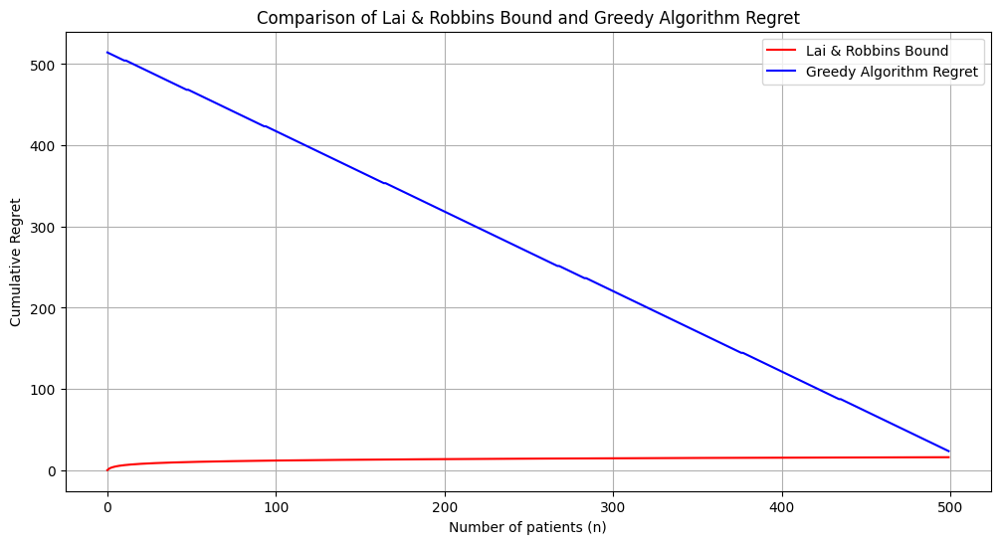

In [9]:

# Calcule de la distance KL
def kl_divergence(mu_i, mu_star):
    return mu_i * np.log(mu_i / mu_star) + (1 - mu_i) * np.log((1 - mu_i) / (1 - mu_star))

# Calcule de la borne de Lai & Robbins
def lai_robbins_bound(mus, mu_star, n):
    C_mu = sum((mu_star - mu_i) / kl_divergence(mu_i, mu_star) for mu_i in mus if mu_i < mu_star)
    return C_mu * np.log(n)



def greedy_algorithm(MAB, N, M):
    rewards = torch.zeros(K, dtype=torch.float)
    trials = torch.zeros(K, dtype=torch.float)
    total_reward = 0
    regrets = []
    n = N + M
    # Exploration
    for _ in range(N):
        i = torch.randint(0, K, (1,)).item()
        reward = MAB[i].sample().float().item()
        rewards[i] += reward
        trials[i] += 1

    empirical_means = rewards / trials
    best_vaccine = torch.argmax(empirical_means).item()

    # Exploitation
    total_reward = rewards.sum().item()
    for _ in range(M):
        reward = MAB[best_vaccine].sample().float().item() #
        rewards[best_vaccine] += reward
        trials[best_vaccine] += 1
        total_reward += reward # 
        regret = n * find_mu_star_value(MAB) - total_reward
        regrets.append(regret)

    return regrets

K = 5
N = 50
M = 500
MAB = generate_arms(K)
mus = [arm.immunity_rate for arm in MAB]
mu_star = find_mu_star_value(MAB)
lai_robbins_regret = [lai_robbins_bound(mus, mu_star, n) for n in range(1, M + 1)]
greedy_regret = greedy_algorithm(MAB, N, M)

plt.figure(figsize=(12, 6))
plt.plot(lai_robbins_regret, label="Lai & Robbins Bound", color='red')
plt.plot(greedy_regret, label="Greedy Algorithm Regret", color='blue')

plt.xlabel("Number of patients (n)")
plt.ylabel("Cumulative Regret")

plt.title("Comparison of Lai & Robbins Bound and Greedy Algorithm Regret")
plt.legend()
plt.grid(True)
plt.show()


La borne inférieure de Lai et Robbins (1985) pour le problème des bandits multi-bras est donnée par :

$$
\lim \inf_{n \rightarrow \infty} \frac{\sum_{k=0}^{n-1} R_k}{\log n} \geq \sum_{i~\text{tel que}~\mu_i < \mu^*} \frac{\mu^* - \mu_i}{\text{KL}(\mu_i, \mu^*)} := C(\mu)
$$

où

$$
\text{KL}(\mu_i, \mu^*) = \mu_i \log\left(\frac{\mu_i}{\mu^*}\right) + (1 - \mu_i) \log\left(\frac{1 - \mu_i}{1 - \mu^*}\right)
$$

donc :

$$
\lim \inf_{n \rightarrow \infty} \frac{\sum_{k=0}^{n-1} R_k}{\log n} \geq C(\mu)
$$

donc :

$$
\sum_{k=0}^{n-1} R_k \geq C(\mu) \cdot \log n
$$

d'où :

$$
Regret_{Lai\&Robbins}(n) = C(\mu) \cdot \log(n)
$$

Ici, on observe que le regret issu de la borne de Lai & Robbins est bien inférieur au regret obtenu avec l'algorithme glouton.



## I.c. Upper Confidence Bounds

Cet algorithme améliore la version précédente en ajoutant un biais lié à la fréquentation de chaque vaccin :

$$\bar{\mu}_i = \hat{\mu}_i + \sqrt{\frac{C\log{n}}{T_i}}$$,

avec $C=2$.


**Q8. Implémentez la modification de cet algorithme. Observez un intérêt à conserver $N > 0$ ? Et $\epsilon < 1$ ? Expliquez pourquoi.**

Dans la suite, on prendra $N = 0$ et $\epsilon = 1$.

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

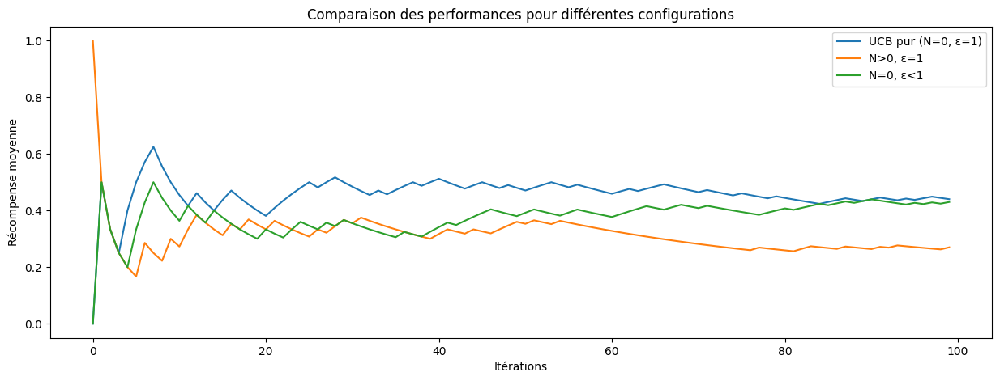

Taux d'immunisation empiriques:
UCB pur: [0.18181818 0.47826087 0.53571429 0.53571429 0.1       ]
N>0: [0.15384615 0.31578947 0.55555556 0.28571429 0.13043478]
ε<1: [0.1        0.42857143 0.63043478 0.23076923 0.1       ]

Vrais taux d'immunisation: [0.19735041 0.37321244 0.50687102 0.33178828 0.06367295]


In [10]:
def ucb_algorithm(N, epsilon, C, num_vaccines, num_iterations):

    successes = np.zeros(num_vaccines)
    trials = np.zeros(num_vaccines)
    
    total_reward = 0
    rewards = []
    for n in tqdm(range(1, num_iterations + 1)):
        if n <= N:
            vaccine = np.random.randint(num_vaccines)
        
        else:
            if np.random.random() < epsilon:
                vaccine = np.argmax(successes / np.maximum(trials, 1) + np.sqrt((C * np.log(n)) / np.maximum(trials, 1)))
            
            else:
                vaccine = np.random.randint(num_vaccines)
        
        reward = np.random.binomial(1, true_probs[vaccine])
        total_reward += reward
        rewards.append(total_reward / n)
        
        successes[vaccine] += reward
        trials[vaccine] += 1
    
    return rewards, successes, trials

num_vaccines = 5
num_iterations = 100
true_probs = np.random.random(num_vaccines)

# Test 1: N = 0, epsilon = 1 (UCB pur)
rewards_ucb, successes_ucb, trials_ucb = ucb_algorithm(0, 1, 2, num_vaccines, num_iterations)

# Test 2: N > 0, epsilon = 1
rewards_N, successes_N, trials_N = ucb_algorithm(100, 1, 2, num_vaccines, num_iterations)
# Test 3: N = 0, epsilon < 1
rewards_eps, successes_eps, trials_eps = ucb_algorithm(0, 0.9, 2, num_vaccines, num_iterations)

plt.figure(figsize=(15, 5))

plt.plot(rewards_ucb, label='UCB pur (N=0, ε=1)')
plt.plot(rewards_N, label='N>0, ε=1')
plt.plot(rewards_eps, label='N=0, ε<1')

plt.xlabel('Itérations')
plt.ylabel('Récompense moyenne')
plt.legend()
plt.title('Comparaison des performances pour différentes configurations')
plt.show()

print("Taux d'immunisation empiriques:")
print("UCB pur:", successes_ucb / trials_ucb)
print("N>0:", successes_N / trials_N)
print("ε<1:", successes_eps / trials_eps)

print("\nVrais taux d'immunisation:", true_probs)


- UCB pur (N=0, ε=1) :
L'algorithme explore beaucoup (grâce au 𝜖=1), mais cela le ralentit au début, car il passe beaucoup de temps à tester des bras moins efficaces avant de converger vers les meilleurs.
- N>0, ε=1 :
Cette configuration a un bon début, car elle fait une exploration initiale avec 𝑁>0
N>0, mais elle continue de beaucoup explorer, ce qui empêche une exploitation efficace des meilleurs bras dans les dernières itérations.
- N=0, ε<1 :
Cet arrangement semble être le plus efficace, car il trouve rapidement les bons vaccins et les exploite bien. Ce qui conduit à une récompense moyenne plus élevée plus tôt dans les itérations.

Mais les résultats sont assez semblables donc tout cela reste à nuancer.

**Q9. Tracez sous la forme d'une animation l'évolution des taux d'immunisation empirique (fig. de gauche) et l'évolution du regret (fig. droite). Dans la figure de gauche, vous representerez $\bar{\mu}_i$ et $\hat{\mu}_i$ pour chaque vaccin.**

Animation size has reached 21046556 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


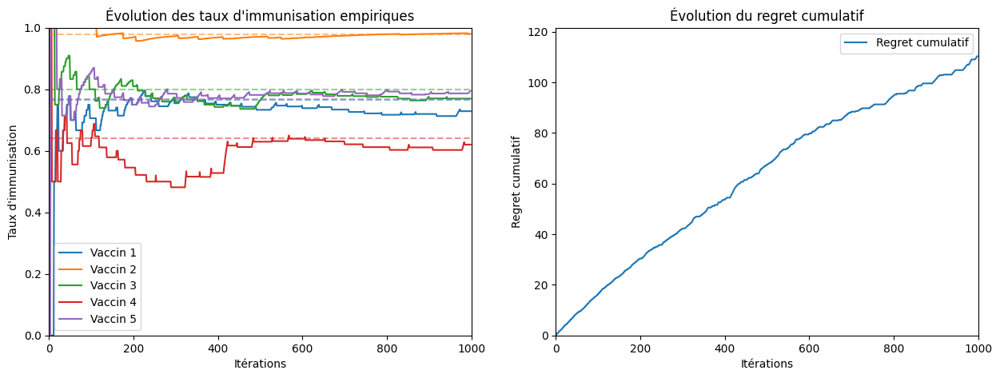

In [11]:
def ucb_algorithm(true_probs, num_iterations, C=2):
    
    num_vaccines = len(true_probs)
    empirical_means = np.zeros(num_vaccines)
    counts = np.zeros(num_vaccines)
    rewards = []
    empirical_rates = []
    regrets = []
    
    for t in range(1, num_iterations + 1):
        ucb_values = empirical_means + C * np.sqrt(np.log(t) / (counts + 1e-9))
        chosen_vaccine = np.argmax(ucb_values)
        
        # Simulate vaccination
        reward = np.random.random() < true_probs[chosen_vaccine]
        # Update statistics
        counts[chosen_vaccine] += 1

        empirical_means[chosen_vaccine] += (reward - empirical_means[chosen_vaccine]) / counts[chosen_vaccine]
    
        rewards.append(reward)
        empirical_rates.append(empirical_means.copy())
        regrets.append(np.max(true_probs) - true_probs[chosen_vaccine])
    
    return np.array(empirical_rates), np.cumsum(regrets)

# Set up the animation
num_iterations = 1000

#true_probs = np.array([0.3, 0.5, 0.7])
true_probs = np.random.random(5)


empirical_rates, cumulative_regrets = ucb_algorithm(true_probs, num_iterations)



fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
# Lines for empirical rates (\hat{\mu}_i)
lines1 = [ax1.plot([], [], label=f'Vaccin {i+1}')[0] for i in range(len(true_probs))]
# Lines for theoretical true rates (\bar{\mu}_i)
true_lines1 = [ax1.axhline(y=prob, color=f'C{i}', linestyle='--', alpha=0.5) for i, prob in enumerate(true_probs)]
ax1.set_xlim(0, num_iterations)
ax1.set_ylim(0, 1)
ax1.set_xlabel('Itérations')
ax1.set_ylabel('Taux d\'immunisation')
ax1.set_title('Évolution des taux d\'immunisation empiriques')
ax1.legend()

# Line for cumulative regret
line2, = ax2.plot([], [], label='Regret cumulatif')
ax2.set_xlim(0, num_iterations)
ax2.set_ylim(0, np.max(cumulative_regrets) * 1.1)
ax2.set_xlabel('Itérations')
ax2.set_ylabel('Regret cumulatif')
ax2.set_title('Évolution du regret cumulatif')
ax2.legend()

def init():
    for line in lines1:
        line.set_data([], [])
    line2.set_data([], [])
    return lines1 + [line2]

def animate(frame):
    for i, line in enumerate(lines1):
        line.set_data(range(frame), empirical_rates[:frame, i])
    line2.set_data(range(frame), cumulative_regrets[:frame])
    return lines1 + [line2]

anim = FuncAnimation(fig, animate, frames=num_iterations, init_func=init, blit=True, interval=20)

HTML(anim.to_jshtml())


#### Figure de gauche "Évolution des taux d'immunisation empiriques" :
- Les lignes pleines représentent les taux d'immunisation empiriques $\hat{\mu}_i$ pour chaque vaccin.
- Les lignes pointillées horizontales représentent les taux d'immunisation théoriques ${\mu}_i$, c'est-à-dire les vraies probabilités de succès pour chaque vaccin.

Enfait Les courbes empiriques $\hat{\mu}_i$ vont converger au fur et a mesure vers les vraies valeurs ${\mu}_i$. Cela signifie que l'algorithme progresse vers le vaccin ayant la meilleure efficacité.
Donc si une courbe empirique est proche de sa ligne théorique, cela indique que l'algorithme apprend à exploiter ce vaccin. Plus la convergence est rapide, plus l'algorithme explore et exploite efficacement.

#### Figure de droite "Évolution du regret cumulatif" :
Le regret augmente fortement et progresse linéairement car l'algorithme explore et teste différents vaccins.
Cependant, à partir d'un certain nombre d'itérations, on estime que le regret devrait se stabilisera. Cela est dû au fait que l'algorithme a convergé.

**Q10. Reprenez la question Q5 avec cette algorithme. Concluez sur l'utilité (ou l'inutilité) de la phase d'exploration. Comparez les performances d'UCB avec celles de l'algorithme glouton.**

*[Ajoutez votre commentaire ici]*

**Q11. Testez différentes valeurs pour $C$ et trouvez sa valeur optimale expérimentalement.**

*[Ajoutez votre commentaire ici]*

# Echantillonnage de Thomson

Cet algorithme propose de modéliser la variable aléatoire de chaque vaccin avec une loi $\beta$ dont les paramètres $a$ et $b$ correspondent au nombre de patients que le vaccin a immunisés (resp. non immunisés).

Pour chaque patient, on tire un valeur aléatoire pour la loi $\beta$ décrivant chaque vaccin, puis on choisit le vaccin avec la plus grande valeur tirée. 

**Q12. Implémentez cet algorithme. En testant plusieurs valeurs de $N$, montrez que la phase d'exploration précédente a un impact très limité. Cela veut-il dire que l'algorithme ne contient pas d'initialisation ?**

  0%|          | 0/550 [00:00<?, ?it/s]

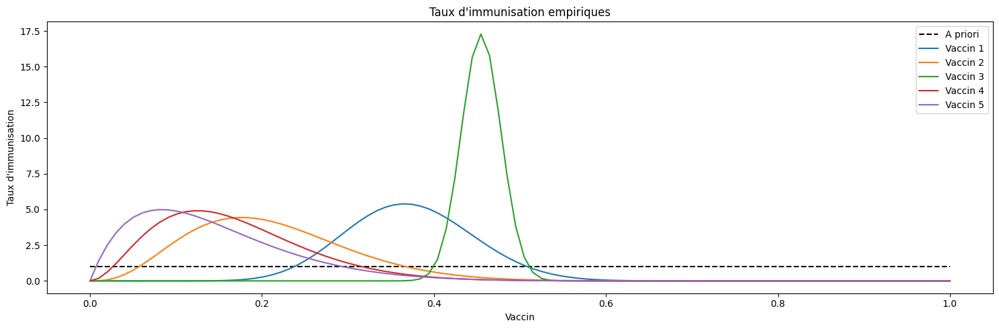

Regret final: 12.294815063476562


  0%|          | 0/550 [00:00<?, ?it/s]

Récompense moyenne pour N=0: 0.4036363661289215


  0%|          | 0/550 [00:00<?, ?it/s]

Récompense moyenne pour N=50: 0.3690909147262573


  0%|          | 0/550 [00:00<?, ?it/s]

Récompense moyenne pour N=100: 0.46727272868156433


In [12]:

def thompson_sampling(MAB, N, M):
    successes = torch.zeros(K)
    failures = torch.zeros(K)
    rewards = torch.zeros(N + M)
    chosen_arms = torch.zeros(N + M, dtype=torch.long)
    
    for n in tqdm(range(N + M)):
        # Sample from beta distributions
        samples = torch.distributions.Beta(successes + 1, failures + 1).sample()
        
        # Choose arm with highest sample
        chosen_arm = torch.argmax(samples).item()
        chosen_arms[n] = chosen_arm
        
        # Generate reward
        reward = MAB[chosen_arm].sample().float().item()
        rewards[n] = reward
        
        # Update beta distribution parameters
        if reward == 1:
            successes[chosen_arm] += 1
        else:
            failures[chosen_arm] += 1
    
    return rewards, chosen_arms, successes, failures

# Variables
N = 50 
M = 500  
K = 5  

MAB = generate_arms(K)

# Run Thompson Sampling
rewards, chosen_arms, successes, failures = thompson_sampling(MAB, N, M)
cumulative_reward = torch.cumsum(rewards, dim=0)
optimal_reward = find_mu_star_value(MAB) * torch.arange(1, N + M + 1)

regret = optimal_reward - cumulative_reward

# Plot
fig, (ax1) = plt.subplots(1, 1, figsize=(15, 5))
ax1.set_title('Taux d\'immunisation empiriques')
ax1.set_xlabel('Vaccin')
ax1.set_ylabel('Taux d\'immunisation')


# A priori (distribution Beta(1, 1))
x = np.linspace(0, 1, 100)
prior = torch.distributions.Beta(1, 1).log_prob(torch.tensor(x)).exp()
ax1.plot(x, prior, 'k--', label='A priori')
# A posteriori
for i in range(K):
    posterior = torch.distributions.Beta(successes[i] + 1, failures[i] + 1).log_prob(torch.tensor(x)).exp()
    ax1.plot(x, posterior, label=f'Vaccin {i+1}')



ax1.legend()

plt.tight_layout()
plt.show()

print(f"Regret final: {regret[-1].item()}")

# Test different values of N
N_values = [0, 50, 100]
for N_test in N_values:
    M_test = N + M - N_test  # Garder le nombre total de patients constant
    rewards, _, _, _ = thompson_sampling(MAB, N_test, M_test)
    print(f"Récompense moyenne pour N={N_test}: {rewards.mean().item()}")

Le graphique montre :
- Les taux d'immunisation empiriques pour chaque vaccin, montrant la distribution a priori (Beta(1,1)) et les distributions a posteriori après l'expérience.

- Les distributions a posteriori des taux d'immunisation se sont affinées au fil du temps, se concentrant autour des vraies valeurs pour chaque vaccin.

- Enfait au départ identiquement distribuée, les lois de chaque variable (vaccin) vont s'affiner au fil du temps par rapport au nombre de fois où elles ont été tirées, et bien entendu à la récompense qu'elles ont apporté. Au fur et à mesure sont mis à jour leurs espérance et variance. Donnant ainsi l'image des courbes qui se "tassent" autour de la moyenne.

Concernant la phase d'exploration/initialisation :
Les distributions ayant une variance très élevée, on pourrait effectuer une grand phase d'exploration.
Mais l
Personnellement, je trouve que l'échantillonage de Thompson est assez efficace. Il a réussi à retrouver facilement le bon vaccin en maximisant le gain à chaque fois qu'il a été choisi.

**Q13. Tracez sous la forme d'une animation l'évolution des taux d'immunisation empirique (fig. de gauche) et l'évolution du regret (fig. droite). Dans la figure de gauche, vous representerez le taux d'immunisation empirique  pour chaque vaccin avec un [graphique en violon](https://en.wikipedia.org/wiki/Violin_plot) qui représente la loi beta associée à chaque vaccin.**

*[Ajoutez votre commentaire ici]*

**Q14. Comparez le regret avec les autres algorithmes.**

*[Ajoutez votre commentaire ici]*

# Conclusion

**Q15. Calculez le regret des algorithmes glouton, UCB & Thomson lorsqu'il y a un grand nombre de vaccins disponibles (K=100) (on prendra N=100). Faites le lien avec la [malédiction de la dimension](https://fr.wikipedia.org/wiki/Fl%C3%A9au_de_la_dimension).**

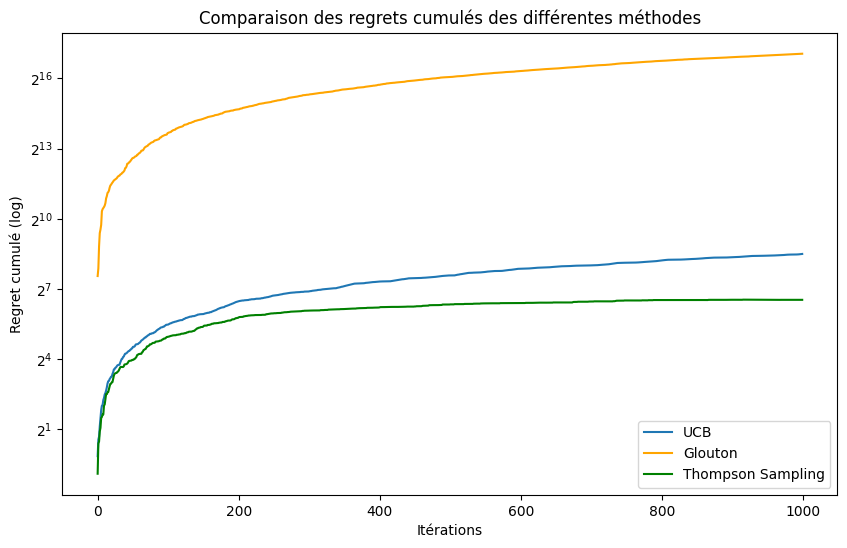

Regrets finaux :
UCB : 358.89
Glouton : 136543.77
Thompson Sampling : 91.98


In [13]:
def ucb_algorithm(MAB, num_iterations, C=2):
    num_vaccines = len(MAB)
    empirical_means = np.zeros(num_vaccines)
    counts = np.zeros(num_vaccines)
    regrets = []
    
    mu_star = find_mu_star_value(MAB)
    
    for t in range(1, num_iterations + 1):
        ucb_values = empirical_means + C * np.sqrt(np.log(t) / (counts + 1e-9))
        chosen_vaccine = np.argmax(ucb_values)
        
        # Simulate vaccination
        reward = MAB[chosen_vaccine].sample().float().item()
        
        # Update statistics
        counts[chosen_vaccine] += 1
        empirical_means[chosen_vaccine] += (reward - empirical_means[chosen_vaccine]) / counts[chosen_vaccine]
        
        # Regret
        regret = mu_star - MAB[chosen_vaccine].immunity_rate
        regrets.append(regret)
    
    return np.cumsum(regrets)

# Thompson Sampling Algorithm
def thompson_sampling(MAB, N, M, num_iterations):
    K = len(MAB)
    successes = np.zeros(K)
    failures = np.zeros(K)
    rewards = np.zeros(K)
    trials = np.zeros(K)
    regrets = []
    
    #for _ in range(N + M):
    for _ in range(num_iterations):
        samples = np.random.beta(successes + 1, failures + 1)
        chosen_arm = np.argmax(samples)
        
        # Simulate vaccination
        reward = MAB[chosen_arm].sample().float().item()
        
        # Update beta distribution parameters
        if reward == 1:
            successes[chosen_arm] += 1
        else:
            failures[chosen_arm] += 1
        
        # Regret
        regret = mu_star - MAB[chosen_arm].immunity_rate
        regrets.append(regret)
    
    return np.cumsum(regrets)


def greedy_solution(MAB: t.List[ArmBernoulli], N: int = 50 , M: int = 500 ):
    K = 5
    rewards = torch.zeros(K)
    trials = torch.zeros(K)

    # Exploration
    for i in range(0,N,1):
        arm_index = torch.randint(0, K, (1,)).item()
        reward = MAB[arm_index].sample().float().item()
        rewards[arm_index] += reward
        trials[arm_index] += 1
    
    empirical_means = rewards / trials
    best_vaccine = torch.argmax(empirical_means).item()

    # Exploitation
    total_reward = rewards.sum().item()
    for i in range(0, M, 1):
        reward = MAB[best_vaccine].sample().float().item()
        total_reward += reward
    
    return total_reward, rewards, trials


def simulate_greedy_algorithm(MAB, N: int = 50, M: int = 500, num_simulations: int = 100):
    regrets = []
    exploration_successes = []

    for i in range(0, num_simulations, 1):
        MAB = generate_arms(K) # K arms
        mu_star = find_mu_star_value(MAB)
        total_reward, rewards, trials = greedy_solution(MAB, N, M)
        
        total_patients = N + M
        regret = total_patients * mu_star - total_reward
        regrets.append(regret)
        
        best_vaccine_index = torch.argmax(torch.tensor([arm.immunity_rate for arm in MAB])).item()
        if (best_vaccine_index == torch.argmax(rewards / trials).item()):
            exploration_successes.append(1)
        else:
            exploration_successes.append(0)
    return np.cumsum(regrets)



# Paramètres
K = 100
N = 100
M = 500
num_iterations = 1000
MAB = generate_arms(K)

# Calculs des regrets cumulés
ucb_regret = ucb_algorithm(MAB, num_iterations)
thompson_regret = thompson_sampling(MAB, N, M,num_iterations)
greedy_regret = simulate_greedy_algorithm(MAB, N, M, num_simulations=num_iterations)

# Plot
plt.figure(figsize=(10, 6))
plt.plot(range(len(ucb_regret)), ucb_regret, label='UCB')
plt.plot(range(len(greedy_regret)), greedy_regret, label='Glouton', color='orange')
plt.plot(range(len(thompson_regret)), thompson_regret, label='Thompson Sampling', color='green')
plt.xlabel('Itérations')
plt.ylabel('Regret cumulé (log)')
plt.yscale('log',base=2) 
plt.title('Comparaison des regrets cumulés des différentes méthodes')
plt.legend()
plt.show()

print(f"Regrets finaux :")
print(f"UCB : {ucb_regret[-1]:.2f}")
print(f"Glouton : {greedy_regret[-1]:.2f}")
print(f"Thompson Sampling : {thompson_regret[-1]:.2f}")

Dans cette étude comparative des algorithmes glouton, UCB, et Thompson Sampling appliqués à un problème de multi-bras avec un grand nombre de vaccins disponibles (K=100).
Nous avons observé des différences significatives dans leurs performances respectives en termes de regret cumulatif.
Attention, l'axe des ordonnées du dernier graphique est à l'échelle logarithmique.
Chaque méthode aborde de manière distincte le dilemme exploration-exploitation à sa manière.

- L'algorithme glouton souffre particulièrement du fait qu'il se base exclusivement sur l'exploitation des récompenses déjà observées. Dès lors, une mauvaise décision initiale peut entraîner une stagnation dans un choix sous-optimal.
Cela est particulièrement vrai dans des contextes où le nombre de bras est élevé, comme ici avec 100 vaccins. Le modèle glouton manque de flexibilité et peut facilement s'enfermer dans un optimum local, ce qui se traduit par un regret élevé à long terme.

- L'algorithme UCB parvient à mieux équilibrer l'exploration et l'exploitation. Sa capacité à ajuster les bornes de confiance permet d'allouer plus de ressources aux bras moins explorés tout en se concentrant sur ceux qui semblent prometteurs. Cela permet à UCB de corriger rapidement les choix sous-optimaux initiaux, surtout dans des environnements avec de nombreux bras, bien que le coût en regret initial puisse encore être élevé.

- Le Thompson Sampling, quant à lui, repose sur une approche probabiliste, ce qui lui donne un avantage dans la gestion de l'incertitude. Sa capacité à générer des échantillons pour chaque bras et à ajuster progressivement ses choix en fonction des récompenses observées lui permet de converger efficacement vers le bras optimal. Il a montré un légère performance contre UCB sur le très long terme. En revanche ce résultat reste à nuancer car cette méthode d'échantillonage repose sur la distribution probabiliste dans un contexte donné. Ainsi l'efficacité du Thompson Sampling peut souffrir dépendemment des distributions initiales.

Malédiction de la dimension
Le phénomène observé dans cette expérience est directement lié à la malédiction de la dimension. En augmentant le nombre de bras (K=100), les algorithmes sont confrontés à une nécessité accrue d'explorer un plus grand espace de solutions. Plus il y a de bras, plus il devient difficile de trouver rapidement le bras optimal, car chaque nouvel élément introduit une complexité supplémentaire dans l'exploration. Cela se traduit par une augmentation du regret initial : les algorithmes doivent allouer davantage d'itérations à l'exploration avant de se concentrer sur l'exploitation.
Cela se matérialise sur le dernier graphique par l'énorme bond (car on est en échelle logarithmique) du regret dès les premières itérations.

Dans ce cadre, la probabilité de choisir un vaccin optimal diminue à mesure que K augmente, rendant plus difficile la tâche des algorithmes d'apprentissage par renforcement. Pour résoudre ce problème, des approches adaptées à des espaces hautement dimensionnels, comme la réduction de dimensionnalité ou des stratégies d'exploration plus efficaces, pourraient peut-être être envisagées.